#   IMPORTS

In [1]:
import os
import time
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch import optim
import torchvision
from torchvision import transforms
from PIL import Image, ImageOps
from collections import OrderedDict, defaultdict, Counter
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import numpy as np

/home/antonello03/anaconda3/envs/py31/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
model_dir  = "/home/antonello03/gdrive/Colab Notebooks/UNI/ProjectWork/"
image_path = "/home/antonello03/gdrive/Colab Notebooks/UNI/ProjectWork/Images/"

# Importing Dataset

In [3]:
from pathlib import Path
from PIL import Image

top4styles = ['Impressionism', 'Realism', 'Baroque', 'Romanticism']
root = Path('styles/out')

styles_images = {
    style: [Image.open(p) for p in sorted(root.glob(f'{style}_*.jpg'),
                                          key=lambda q: int(q.stem.split('_')[1]))[:6]]
    for style in top4styles
}

In [4]:
# from datasets import load_dataset, Dataset, disable_caching
# import itertools, datasets

# stream_ds = load_dataset(
#     "huggan/wikiart",
#     split="train",        # the dataset has a single split called “train”
#     streaming=True        # key flag – nothing is cached locally until you touch it
# )

# stream_ds = stream_ds.shuffle(buffer_size=1_000, seed=42)
# first_100 = list(itertools.islice(stream_ds, 100))
# mini_ds = Dataset.from_list(first_100).cast_column("image", datasets.Image())
# style_features = stream_ds.features["style"]
# style_names = style_features.names
# unique_codes = sorted(set(mini_ds["style"]))
# mapping = {i: style_names[i] for i in unique_codes }
# indexesStyles = {i:mapping[s] for i,s in enumerate(mini_ds["style"])}
# counts = Counter(indexesStyles.values())
# labels = list(counts.keys())
# values = list(counts.values())

# # Taking top 4 styles
# top4styles = [el[0] for el in counts.most_common(4)]
# print(top4styles)

# styles_images = defaultdict(list) # {style: list of 6 images}

# for i,s in indexesStyles.items():
#   if s in top4styles and len(styles_images[s])<6:
#     styles_images[s].append(mini_ds["image"][i])

In [5]:
top4styles

['Impressionism', 'Realism', 'Baroque', 'Romanticism']

# Instatiating VGG to get feature activation and compute GRAM Matrices

In [6]:
#vgg definition that conveniently let's you grab the outputs from any layer
class VGG(nn.Module):
    def __init__(self, pool='avg'):
        super(VGG, self).__init__()
        #vgg modules
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_4 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        if pool == 'max':
            self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        elif pool == 'avg':
            self.pool1 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.AvgPool2d(kernel_size=2, stride=2)

    def forward(self, x, out_keys):
        out = {}
        out['r11'] = F.relu(self.conv1_1(x))
        out['r12'] = F.relu(self.conv1_2(out['r11']))
        out['p1'] = self.pool1(out['r12'])
        out['r21'] = F.relu(self.conv2_1(out['p1']))
        out['r22'] = F.relu(self.conv2_2(out['r21']))
        out['p2'] = self.pool2(out['r22'])
        out['r31'] = F.relu(self.conv3_1(out['p2']))
        out['r32'] = F.relu(self.conv3_2(out['r31']))
        out['r33'] = F.relu(self.conv3_3(out['r32']))
        out['r34'] = F.relu(self.conv3_4(out['r33']))
        out['p3'] = self.pool3(out['r34'])
        out['r41'] = F.relu(self.conv4_1(out['p3']))
        out['r42'] = F.relu(self.conv4_2(out['r41']))
        out['r43'] = F.relu(self.conv4_3(out['r42']))
        out['r44'] = F.relu(self.conv4_4(out['r43']))
        out['p4'] = self.pool4(out['r44'])
        out['r51'] = F.relu(self.conv5_1(out['p4']))
        out['r52'] = F.relu(self.conv5_2(out['r51']))
        out['r53'] = F.relu(self.conv5_3(out['r52']))
        out['r54'] = F.relu(self.conv5_4(out['r53']))
        out['p5'] = self.pool5(out['r54'])
        return [out[key] for key in out_keys]

# gram matrix and loss
class GramMatrix(nn.Module):
    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        G = torch.bmm(F, F.transpose(1,2))
        G.div_(h*w)
        return G

class GramMSELoss(nn.Module):
    def forward(self, input, target):
        out = nn.MSELoss()(GramMatrix()(input), target)
        return(out)

# pre and post processing for images
img_size = (512, 512)
prep = transforms.Compose([transforms.Resize(img_size),
                           transforms.ToTensor(),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to BGR
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x.mul_(255)),
                          ])
postpa = transforms.Compose([transforms.Lambda(lambda x: x.mul_(1./255)),
                           transforms.Normalize(mean=[-0.40760392, -0.45795686, -0.48501961], #add imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to RGB
                           ])
postpb = transforms.Compose([transforms.ToPILImage()])
def postp(tensor): # to clip results in the range [0,1]
    t = postpa(tensor)
    t[t>1] = 1
    t[t<0] = 0
    img = postpb(t)
    return img

In [8]:
vgg = VGG()
vgg.load_state_dict(torch.load(model_dir + 'vgg_conv.pth'))

for param in vgg.parameters():
    param.requires_grad = False
if torch.cuda.is_available():
    vgg.cuda()

# Extracting all the Gram Matrices

In [ ]:
image_path = "/content/drive/MyDrive/Colab Notebooks/UNI/ProjectWork/Images/"

style_layers = ['r11','r21','r31','r41', 'r51']

def preprocessing(img):
  img_torch = prep(img)
  if torch.cuda.is_available():
      img_torch = Variable(img_torch.unsqueeze(0).cuda())
  else:
      img_torch = Variable(img_torch.unsqueeze(0))
  return img_torch

def computeGramMatrix(img):
  style_image = preprocessing(img)
  style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
  return style_targets

# -------------RMSE----------------------------

def rmse(t1, t2):
    return ((t1 - t2).pow(2).mean().sqrt())

def computeRMSE(gramMatrixes):
  """
  gramMatrixes -> list of list of gramMatrixes [images x gram Matrixes(5)]

  returns a matrix of the rmses of shape [image1 x image2 x gramLayer]
  """

  n_images = len(gramMatrixes)
  n_gram = len(style_layers)

  rmseMat = torch.zeros(n_images,n_images,n_gram)

  for i in range(n_gram):
    for n in range(n_images):
      for m in range(n_images):
        rmseMat[n][m][i] = rmse(gramMatrixes[n][i],gramMatrixes[m][i])

  return rmseMat

# -------------Pearson----------------------------

def pearson_correlation_scalar(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    assert x.shape == y.shape

    x_flat = x.view(-1).float()
    y_flat = y.view(-1).float()

    mean_x = torch.mean(x_flat)
    mean_y = torch.mean(y_flat)

    xm = x_flat - mean_x
    ym = y_flat - mean_y

    numer = torch.dot(xm, ym)
    denom = torch.sqrt(torch.dot(xm, xm) * torch.dot(ym, ym))
    eps = 1e-8
    r = numer / (denom + eps)
    return r

def pearson_distance(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """
    Restituisce un singolo valore d = 1 - cor(x, y),
    che varia in [0, 2].
    """
    r = pearson_correlation_scalar(x, y)
    return 1.0 - r

import torch

def computePearson(gramMatrixes):
  """
  gramMatrixes -> list of list of gramMatrixes [images x gram Matrixes(5)]

  returns a matrix of the Pearson Correlation Coefficients of shape [image1 x image2 x gramLayer]
  """

  n_images = len(gramMatrixes)
  n_gram = len(style_layers)

  pearsonMat = torch.zeros(n_images,n_images,n_gram)

  for i in range(n_gram):
    for n in range(n_images):
      for m in range(n_images):
        pearsonMat[n][m][i] = pearson_distance(gramMatrixes[n][i],gramMatrixes[m][i])

  return pearsonMat

# -------------Cosine----------------------------

def cosine_similarity_scalar(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """
    Cosine similarity [-1, +1].
    """
    assert x.shape == y.shape

    x_flat = x.view(-1).float()
    y_flat = y.view(-1).float()
    # Dot‐product
    dot_xy = torch.dot(x_flat, y_flat)
    # Norme L2
    norm_x = torch.norm(x_flat, p=2)
    norm_y = torch.norm(y_flat, p=2)
    eps = 1e-8
    cos_sim = dot_xy / (norm_x * norm_y + eps)
    return cos_sim

def cosine_distance(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """
    Calcola una "cosine distance" d = 1 - cos(x,y), che varia da 0 (identici direzionalmente)
    a 2 (opposti).
    """
    cos_sim = cosine_similarity_scalar(x, y)
    return 1.0 - cos_sim

def computeCosineSimilarity(gramMatrixes):
  """
  gramMatrixes -> list of list of gramMatrixes [images x gram Matrixes(5)]

  returns a matrix of the Cosine Similarity of shape [image1 x image2 x gramLayer]
  """
  n_images = len(gramMatrixes)
  n_gram = len(style_layers)

  cosineMat = torch.zeros(n_images,n_images,n_gram)

  for i in range(n_gram):
    for n in range(n_images):
      for m in range(n_images):
        cosineMat[n][m][i] = cosine_distance(gramMatrixes[n][i],gramMatrixes[m][i])

  return cosineMat


# RMSE between all images

In [10]:
#========== HEATMAPS FUNCTIONS =============

def createMosaic(images, cols, rows, downscale_factor = 0.5):
  imgs = images

  # show batch of image in a single subplot
  widths, heights = zip(*(img.size for img in imgs))
  max_w, max_h = max(widths), max(heights)
  padded = []
  for img in imgs:
      padded_img = ImageOps.pad(img, (max_w, max_h), color=(255,255,255))
      padded.append(padded_img)
  mosaic = Image.new('RGB', (max_w * cols, max_h * rows), (255,255,255))
  for idx, img in enumerate(padded):
      r, c = divmod(idx, cols)
      mosaic.paste(img, (c * max_w, r * max_h))

  # DOWNSCALING IMAGES
  down_scale = downscale_factor
  new_size   = (int(mosaic.width*down_scale),
                int(mosaic.height*down_scale))
  mosaic_small = mosaic.resize(new_size, resample=Image.LANCZOS)
  return mosaic

def plotImagesAndDistanceOfGrams(images,distanceMetrics,imgsTitle:str,rows = 2,cols=3, f = False, lossName = "RMSE"):
  """
  images -> list of 6 PIL images
  rmse ->
  style -> just for plot
  rows,cols -> images
  """
  mosaic = createMosaic(images, cols, rows)

  # plot
  fig, axes = plt.subplots(2, 3, figsize=(14, 8), dpi=400)
  axes = axes.flatten()

  # plot pictures
  axes[0].imshow(mosaic)
  axes[0].set_title(f"{imgsTitle}")
  axes[0].axis('off')

  # plot rmse matrixes
  for idx in range(1, 6):
      ax = axes[idx]
      mat = distanceMetrics[..., idx-1].squeeze().cpu().numpy()
      im = ax.imshow(mat, cmap='Blues')
      fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
      # ------ values of pixels -------
      for (x, y), val in np.ndenumerate(mat):
        if f:
          ax.text(y, x, f'{val:.2f}', ha='center', va='center', fontsize = 3)
        else:
          ax.text(y, x, f'{val:.0f}', ha='center', va='center', fontsize = 3)
      # ------ adding lines to separate styles ------
      for pos in [5.5, 11.5, 17.5]:
          ax.axhline(pos, linewidth=1, color='black')            # horizontal borders
          ax.axvline(pos, linewidth=1, color='black')            # vertical borders

      # --- add tiny labels to the 4×4 blocks ----------------------------
      centers = [2.5, 8.5, 14.5, 20.5]          # pixel-centres of each 6×6 block
      ax.set_xticks(centers)                    # bottom labels
      ax.set_yticks(centers)                    # left labels
      ax.set_xticklabels(top4styles, fontsize=5)
      ax.set_yticklabels(top4styles, fontsize=5)
      ax.xaxis.set_ticks_position('bottom')     # put x-ticks at the bottom
      ax.tick_params(axis='both', length=0, pad=2)


      ax.set_title(f"{lossName} between Gram Matrices of Layer {idx}")
      for spine in ax.spines.values():
          spine.set_visible(False)

  plt.tight_layout()
  plt.show()

In [11]:
imgs = list()
for style in top4styles:
  imgs += styles_images[style]
grams = [computeGramMatrix(img) for img in imgs]
RMSE = computeRMSE(grams)
RMSE_tmp = RMSE.view(24*24,5)
normalizedRMSE = RMSE_tmp / RMSE_tmp.max(dim=0)[0]
normalizedRMSE = normalizedRMSE.view(24,24,5)

# Different Losses HeatMaps

## RMSE Unnormalized

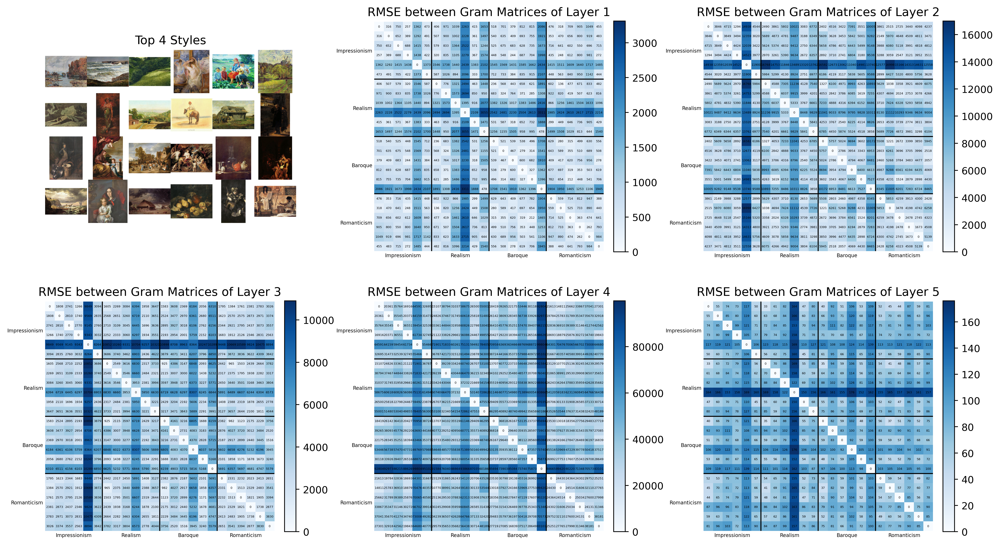

In [12]:
plotImagesAndDistanceOfGrams(imgs, RMSE, imgsTitle = "Top 4 Styles", rows = 4, cols = 6, f = False, lossName = "RMSE")

## RMSE Normalized by Max

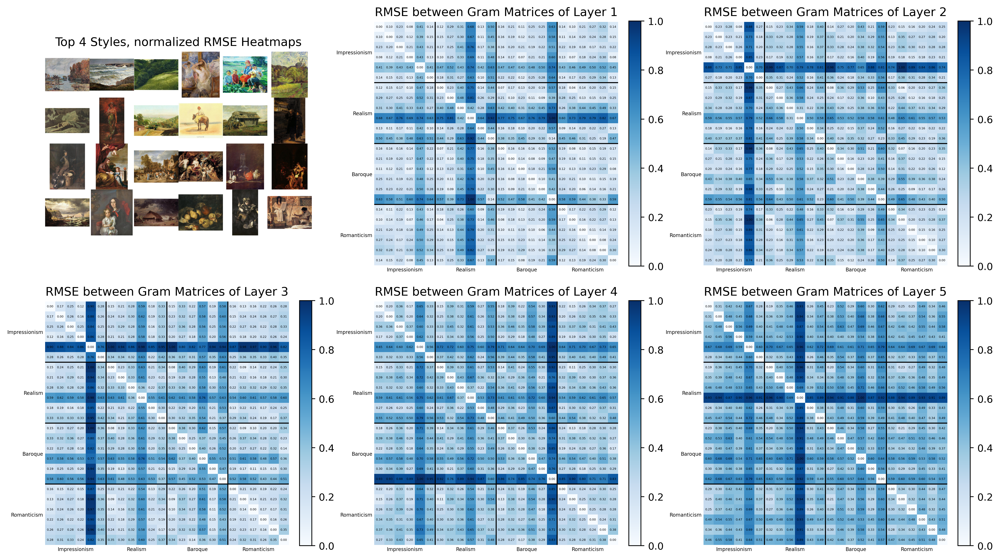

In [13]:
plotImagesAndDistanceOfGrams(imgs, normalizedRMSE, imgsTitle = "Top 4 Styles, normalized RMSE Heatmaps", rows = 4, cols = 6, f = True, lossName = "RMSE")

## Pearson Normalized by Max

In [14]:
Pearsons = computePearson(grams)
Pearsons_tmp = Pearsons.view(24*24,5)
normalizedPearsons = Pearsons_tmp / Pearsons_tmp.max(dim=0)[0]
normalizedPearsons = normalizedPearsons.view(24,24,5)

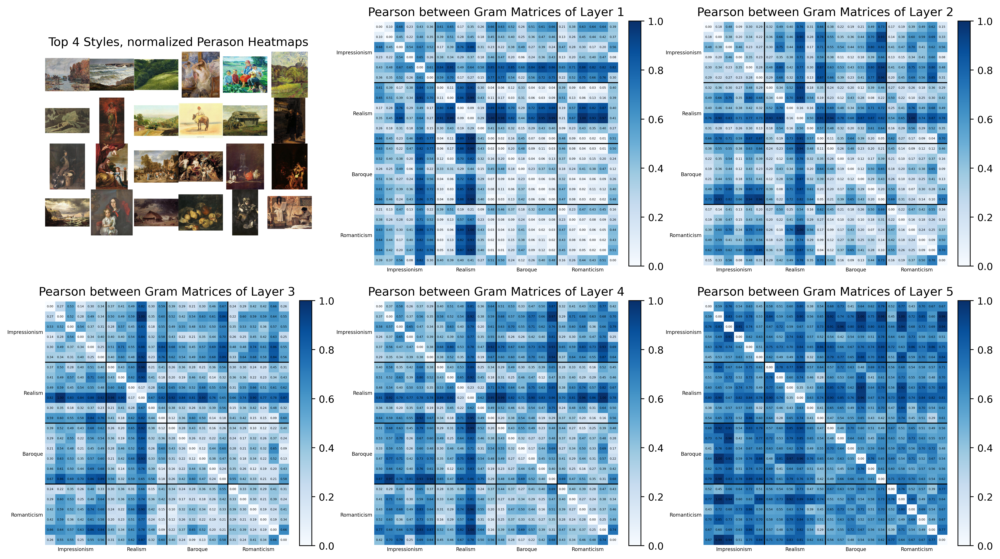

In [15]:
plotImagesAndDistanceOfGrams(imgs, normalizedPearsons, imgsTitle = "Top 4 Styles, normalized Perason Heatmaps", rows = 4, cols = 6, f = True, lossName = "Pearson")

## Cosine Normalized By Max

In [16]:
Cosines = computeCosineSimilarity(grams)
Cosines_tmp = Cosines.view(24*24,5)
normalizedCosines = Cosines_tmp / Cosines_tmp.max(dim=0)[0]
normalizedCosines = normalizedCosines.view(24,24,5)

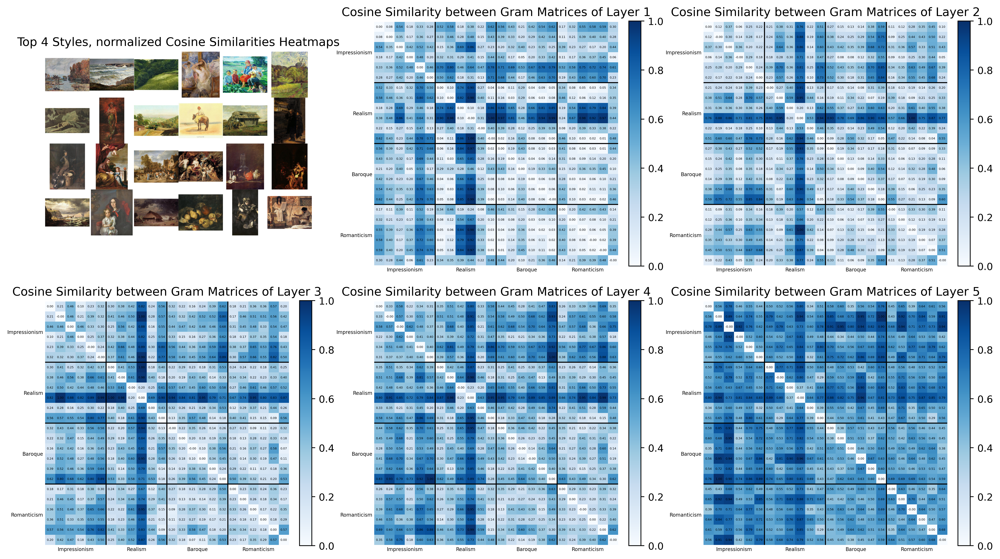

In [17]:
plotImagesAndDistanceOfGrams(imgs, normalizedCosines, imgsTitle = "Top 4 Styles, normalized Cosine Similarities Heatmaps", rows = 4, cols = 6, f = True, lossName = "Cosine Similarity")

# Averaging By Gram Levels

In [18]:
normalizedRMSE_averagedAcrossGram = torch.mean(normalizedRMSE, dim=2)
print(normalizedRMSE.shape)
print(normalizedRMSE_averagedAcrossGram.shape)

torch.Size([24, 24, 5])
torch.Size([24, 24])


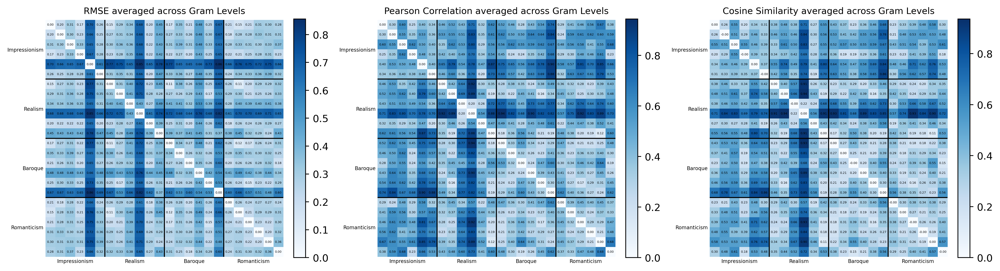

In [19]:
normalizedRMSE_averagedAcrossGram = torch.mean(normalizedRMSE, dim=2)
normalizedPearsons_averagedAcrossGram = torch.mean(normalizedPearsons, dim=2)
normalizedCosines_averagedAcrossGram = torch.mean(normalizedCosines, dim=2)

distanceMetrics = torch.stack((normalizedRMSE_averagedAcrossGram, normalizedPearsons_averagedAcrossGram, normalizedCosines_averagedAcrossGram), dim=-1)
lossNames = ["RMSE", "Pearson Correlation", "Cosine Similarity"]

fig, axes = plt.subplots(1, 3, figsize=(14, 5), dpi=400)

# plotting grams
for idx in range(0, 3):
  ax = axes[idx]
  mat = distanceMetrics[..., idx].squeeze().cpu().numpy()
  im = ax.imshow(mat, cmap='Blues')
  fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

  # ------ values of pixels -------
  for (x, y), val in np.ndenumerate(mat):
    ax.text(y, x, f'{val:.2f}', ha='center', va='center', fontsize = 3)

  # ------ adding lines to separate styles ------
  for pos in [5.5, 11.5, 17.5]:
    ax.axhline(pos, linewidth=1, color='black')
    ax.axvline(pos, linewidth=1, color='black')

  # --- add tiny labels to the 4×4 blocks ----------------------------
  centers = [2.5, 8.5, 14.5, 20.5]          # pixel-centres of each 6×6 block
  ax.set_xticks(centers)                    # bottom labels
  ax.set_yticks(centers)                    # left labels
  ax.set_xticklabels(top4styles, fontsize=5)
  ax.set_yticklabels(top4styles, fontsize=5)
  ax.xaxis.set_ticks_position('bottom')     # put x-ticks at the bottom
  ax.tick_params(axis='both', length=0, pad=2)

  ax.set_title(f"{lossNames[idx]} averaged across Gram Levels", fontsize=9, pad=6)
  for spine in ax.spines.values():
      spine.set_visible(False)

plt.tight_layout()
plt.show()

# Bar plot of average Intra-Style vs Inter-Style distance for each of the three losses

## Obtaining averages

First Gram Level Intra Style Distances for each of the 4 styles:  tensor([0.2421, 0.4751, 0.2553, 0.1918])


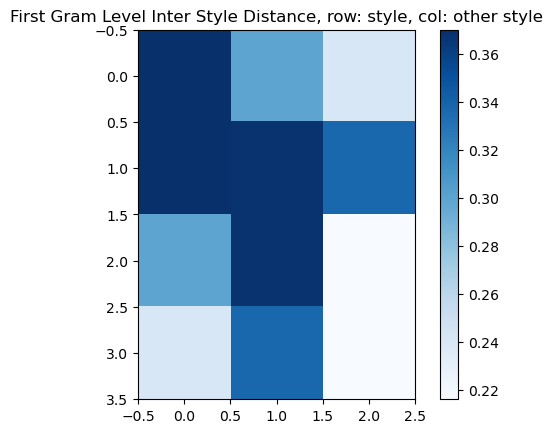

In [20]:
# ===== Obtaining Measures ======

def computeIntraStyleAvgDistance(distanceMatrix):
  """
  Compute the average intra-style distances for each style and Gram layer.

  Parameters:
      distanceMatrix (torch.Tensor): A 3D tensor of shape (24, 24, 5) representing
          pairwise distances between 24 images across 5 Gram layers. The matrix is
          assumed symmetric along the first two dimensions.

  Returns:
      torch.Tensor: A 2D tensor of shape (4, 5), where each row corresponds to one
          of 4 styles (6 images per style), each column corresponds to a Gram layer,
          and each entry is the average distance between all unique pairs of images
          within the same style at that Gram layer.
  """

  completeNormalizedDistanceMat = distanceMatrix

  intraStyle_AvgDistances = torch.zeros((4,5)) # row -> style, col -> Gram Layer

  subgrids_first_idx = [6*i for i in range(0,4)]
  subgrids_last_idx = [6*i for i in range(1,5)]

  for style_idx, (start_range, stop_range) in enumerate(zip(subgrids_first_idx, subgrids_last_idx)): # for each style
    for idx_gram in range(5): # for each gram layer

      intraStyleSubPortion = completeNormalizedDistanceMat[start_range:stop_range,
                                                          start_range:stop_range
                                                          ,idx_gram]

      intraStyleSubPortion_uT = torch.triu(intraStyleSubPortion) # avoid counting twice
      intraStyle_AvgDistances[style_idx, idx_gram] = intraStyleSubPortion_uT.sum()/(5+4+3+2+1) # exclude diagonal

  return intraStyle_AvgDistances

def computeInterStyleAvgDistance(distanceMatrix):
  """
  Compute the average inter-style distances for each style and Gram layer.
  """

  firstRow = distanceMatrix[0:6, 6:, :]
  secondRow = torch.hstack((distanceMatrix[6:12, 0:6, :],distanceMatrix[6:12, 12:, :]))
  thirdRow = torch.hstack((distanceMatrix[12:18, 0:12, :],distanceMatrix[12:18, 18:, :]))
  fourthRow = distanceMatrix[18:24, 0:18, :]

  interStyle_AvgDistances = torch.zeros((4,3,5)) # style x otherStyle x gram level

  for idx_gram in range(5):
    for idx_otherStyle in range(3):
      interStyle_AvgDistances[0,idx_otherStyle,idx_gram] = firstRow[:, 6*idx_otherStyle : 6 * (1 + idx_otherStyle) ,idx_gram].mean()
      interStyle_AvgDistances[1,idx_otherStyle,idx_gram] = secondRow[:, 6*idx_otherStyle : 6 * (1 + idx_otherStyle) ,idx_gram].mean()
      interStyle_AvgDistances[2,idx_otherStyle,idx_gram] = thirdRow[:, 6*idx_otherStyle : 6 * (1 + idx_otherStyle) ,idx_gram].mean()
      interStyle_AvgDistances[3,idx_otherStyle,idx_gram] = fourthRow[:, 6*idx_otherStyle : 6 * (1 + idx_otherStyle) ,idx_gram].mean()

  return interStyle_AvgDistances


print("First Gram Level Intra Style Distances for each of the 4 styles: ",computeIntraStyleAvgDistance(normalizedRMSE)[:,0])
plt.imshow(computeInterStyleAvgDistance(normalizedRMSE)[...,0], cmap='Blues')
plt.colorbar()
plt.title(f"First Gram Level Inter Style Distance, row: style, col: other style")
plt.show()


## Creating Bar plots

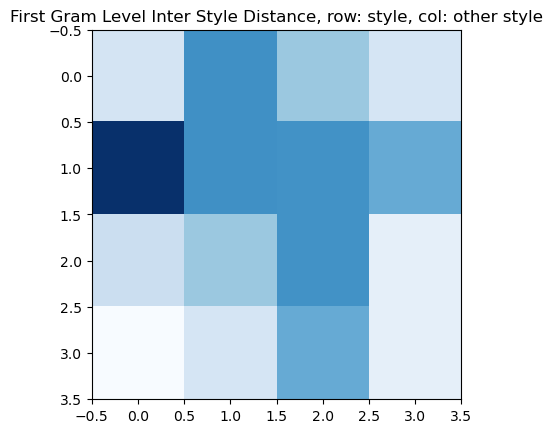

In [21]:
distanceMatrix = normalizedRMSE
intra = computeIntraStyleAvgDistance(distanceMatrix)
inter = computeInterStyleAvgDistance(distanceMatrix)
res = torch.hstack((intra[:,0].unsqueeze(1), inter[:,:,0]))
plt.imshow(res, cmap='Blues')
plt.title(f"First Gram Level Inter Style Distance, row: style, col: other style")
plt.show()

In [22]:
top4styles

['Impressionism', 'Realism', 'Baroque', 'Romanticism']

In [23]:
def createBarPlot(distanceMatrix, title):
  intra = computeIntraStyleAvgDistance(distanceMatrix)
  inter = computeInterStyleAvgDistance(distanceMatrix)

  fig, axs = plt.subplots(5, 1, figsize=(12, 15))

  groups = top4styles
  colors = ['skyblue', 'salmon', 'salmon', 'salmon']
  labels = [['Impr vs Impr', 'Impr vs Real', 'Impr vs Baroq', 'Impr vs Roman'],
            ['Real vs Real', 'Real vs Impr', 'Real vs Baroq', 'Real vs Roman'],
            ['Baroq vs Baroq', 'Baroq vs Impr', 'Baroq vs Real', 'Baroq vs Roman'],
            ['Roman vs Roman', 'Roman vs Impr', 'Roman vs Real', 'Roman vs Baroq']]


  for idx_gram in range(5):
    data = torch.hstack((intra[:,idx_gram].unsqueeze(1), inter[:,:,idx_gram])).T

    bar_w, intra_gap, inter_gap = 0.20, 0.05, 0.40              # width, gap inside cluster, gap between clusters
    idx = np.arange(len(groups)) * (data.shape[0]*(bar_w+intra_gap) - intra_gap + inter_gap)


    # --- plot & label ---
    for j in range(data.shape[0]):
        pos  = idx + j*(bar_w + intra_gap)
        bars = axs[idx_gram].bar(pos, data[j],
                      width=bar_w,
                      color=colors[j],
                      label=labels[j])
        for b in bars:                             # numeric label on each bar
            axs[idx_gram].text(b.get_x()+b.get_width()/2,
                    b.get_height()+0.05,
                    f'{b.get_height():.3f}',
                    ha='center', va='bottom', fontsize=8)

    axs[idx_gram].set_ylim(0, 0.8)
    axs[idx_gram].set_title(f"Gram Level {style_layers[idx_gram]}")

    bar_centers = (idx[:, None]                        # cluster origins
                  + np.arange(4)*(bar_w+intra_gap)     # offsets per series
                  + bar_w/2                            # shift to bar centre
                  ).ravel()

    axs[idx_gram].set_xticks(bar_centers)
    axs[idx_gram].set_xticklabels([x for row in labels for x in row], rotation=40, ha='right', fontsize = 8)


  fig.subplots_adjust(hspace=0.8)   # extra vertical / horizontal gap
  fig.suptitle(title, fontsize=13)
  plt.show()

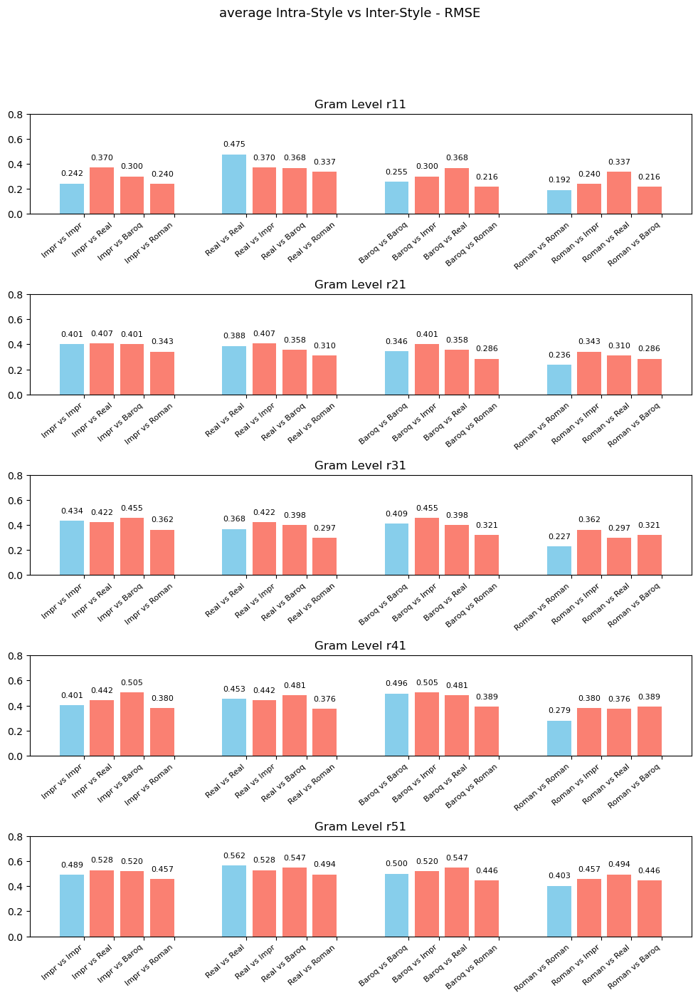

In [24]:
createBarPlot(normalizedRMSE,"average Intra-Style vs Inter-Style - RMSE")

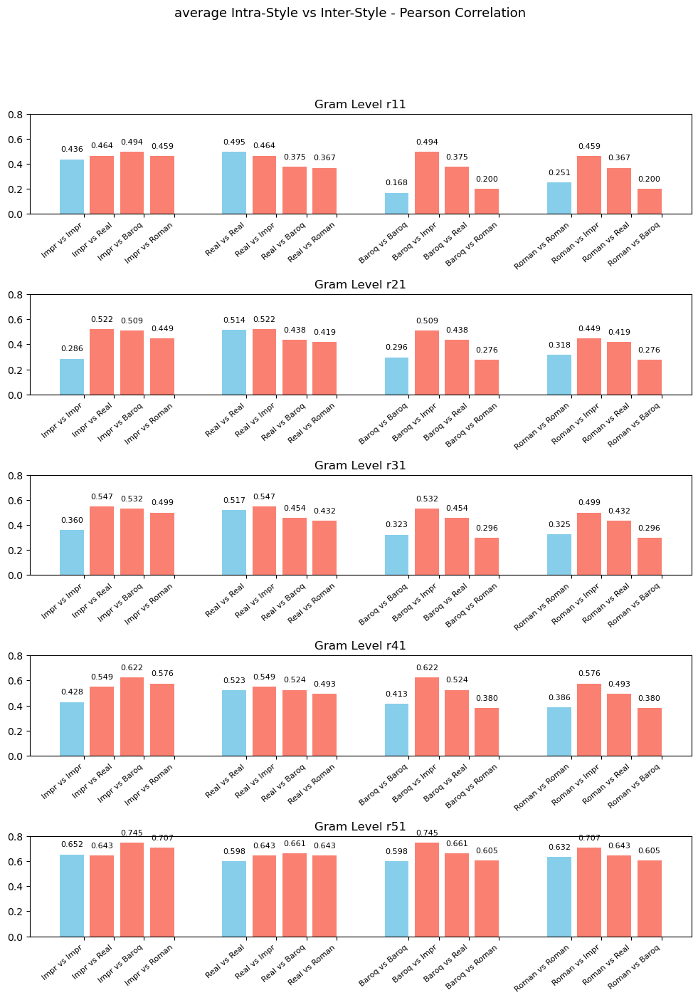

In [25]:
createBarPlot(normalizedPearsons, "average Intra-Style vs Inter-Style - Pearson Correlation")

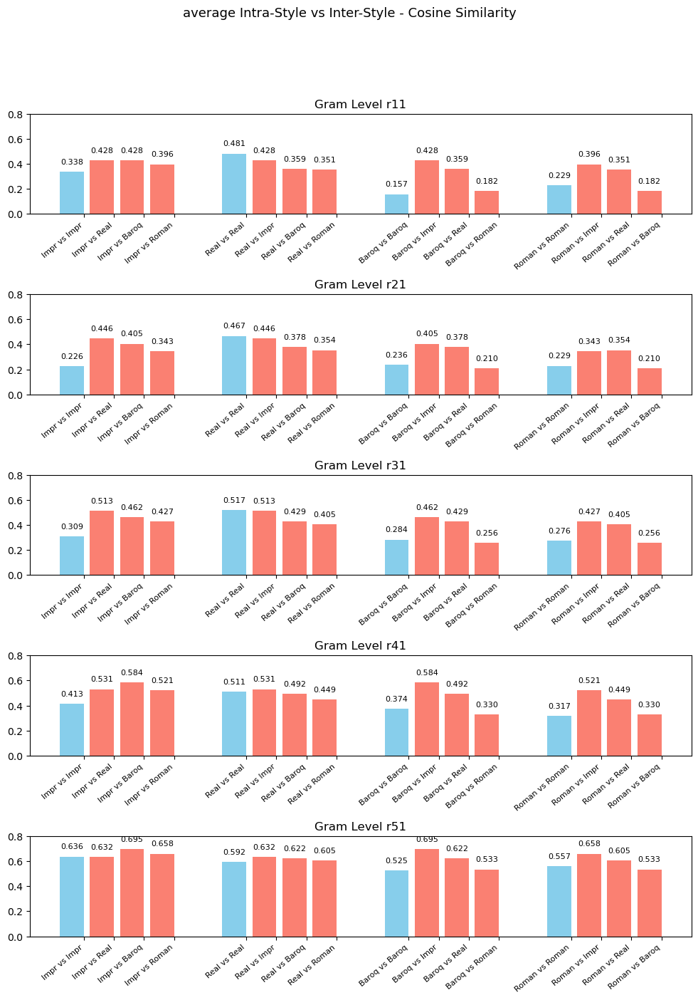

In [26]:
createBarPlot(normalizedCosines, "average Intra-Style vs Inter-Style - Cosine Similarity")

# Summarizing measures

## Average across Gram Layers

In [27]:
def createGramAveragedBarPlot(distanceMatrix, title):

    intra = computeIntraStyleAvgDistance(distanceMatrix).mean(dim=1)
    inter = computeInterStyleAvgDistance(distanceMatrix).mean(dim=2)

    groups = top4styles
    colors = ['skyblue', 'salmon', 'salmon', 'salmon']
    labels = [['Impr vs Impr', 'Impr vs Real', 'Impr vs Baroq', 'Impr vs Roman'],
            ['Real vs Real', 'Real vs Impr', 'Real vs Baroq', 'Real vs Roman'],
            ['Baroq vs Baroq', 'Baroq vs Impr', 'Baroq vs Real', 'Baroq vs Roman'],
            ['Roman vs Roman', 'Roman vs Impr', 'Roman vs Real', 'Roman vs Baroq']]
    
    plt.figure(figsize=(12, 4))  

    data = torch.hstack((intra.unsqueeze(1), inter)).T

    bar_w, intra_gap, inter_gap = 0.20, 0.05, 0.40              # width, gap inside cluster, gap between clusters
    idx = np.arange(len(groups)) * (data.shape[0]*(bar_w+intra_gap) - intra_gap + inter_gap)

    # --- plot & label ---
    for j in range(data.shape[0]):
        pos  = idx + j*(bar_w + intra_gap)
        bars = plt.bar(pos, data[j],
                        width=bar_w,
                        color=colors[j],
                        label=labels[j])
        for b in bars:                             # numeric label on each bar
            plt.text(b.get_x()+b.get_width()/2,
                    b.get_height()+0.05,
                    f'{b.get_height():.3f}',
                    ha='center', va='bottom', fontsize=8)

    plt.ylim(0, 0.8)

    bar_centers = (idx[:, None]                        # cluster origins
                    + np.arange(4)*(bar_w+intra_gap)     # offsets per series
                    + bar_w/2                            # shift to bar centre
                    ).ravel()

    plt.xticks(bar_centers,
            [x for row in labels for x in row],
            rotation=40, ha='right', fontsize=8)

    plt.title(title, fontsize=13)
    plt.show()

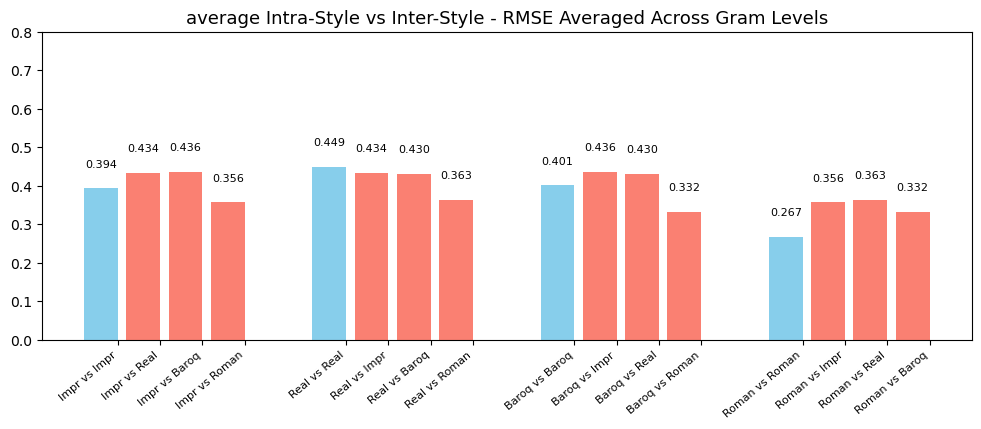

In [28]:
createGramAveragedBarPlot(normalizedRMSE, "average Intra-Style vs Inter-Style - RMSE Averaged Across Gram Levels")

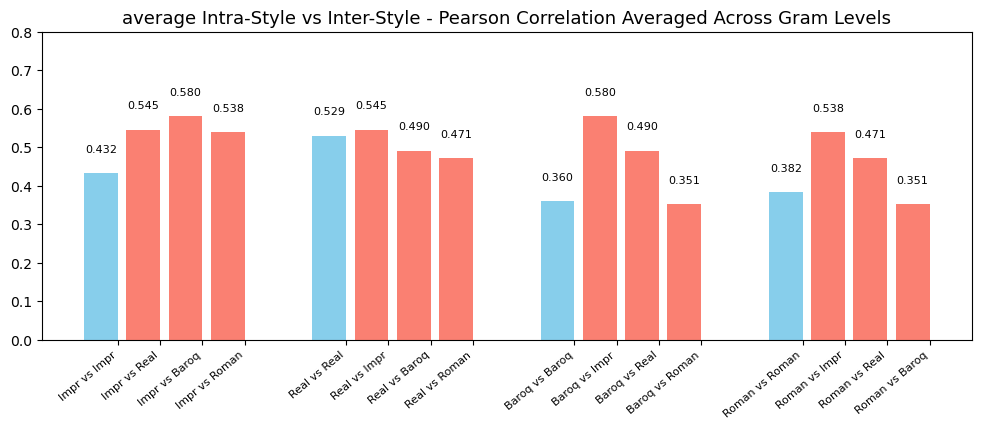

In [29]:
createGramAveragedBarPlot(normalizedPearsons, "average Intra-Style vs Inter-Style - Pearson Correlation Averaged Across Gram Levels")

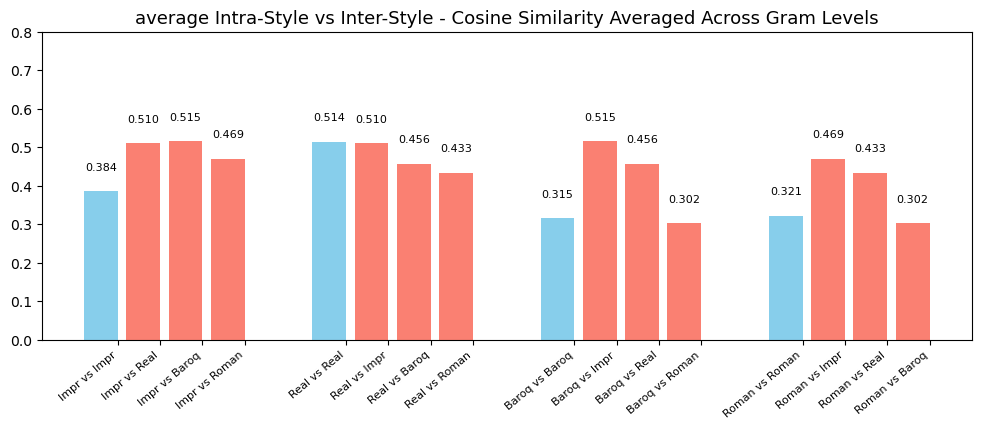

In [30]:
createGramAveragedBarPlot(normalizedCosines, "average Intra-Style vs Inter-Style - Cosine Similarity Averaged Across Gram Levels")

## Average across Styles

In [31]:
def createStyleAveragedBarPlot(distanceMatrix, title):

    intra = computeIntraStyleAvgDistance(distanceMatrix).mean(dim=0).flatten()
    inter = computeInterStyleAvgDistance(distanceMatrix).view(-1, 5).mean(dim=0).flatten()

    fig, axs = plt.subplots(1, 5, figsize=(14, 4), sharey=True)

    colors  = ['skyblue', 'salmon']
    labels  = ['Intra-Style', 'Inter-Style']
    x_pos   = np.arange(2)                           # [0, 1]

    for g in range(5):
        heights = [intra[g].item(), inter[g].item()]

        bars = axs[g].bar(x_pos, heights, color=colors)

        # labels on each bar
        for b in bars:
            axs[g].text(b.get_x() + b.get_width()/2,
                         b.get_height() + 0.02,
                         f'{b.get_height():.3f}',
                         ha='center', va='bottom', fontsize=8)

        # ─── difference (Δ) and ratio × annotation ───
        diff  = heights[1] - heights[0]
        ratio = heights[1] / heights[0] if heights[0] else float('inf')
        axs[g].plot(x_pos, heights, ls='--', c='k')       # dashed connector
        axs[g].text(x_pos.mean(), max(heights) + 0.05,
                     f'Δ {diff:+.3f}\n× {ratio:.2f}',
                     ha='center', va='bottom', fontsize=8)

        axs[g].set_ylim(0, 0.8)
        axs[g].set_title(f'Gram Level {style_layers[g]}')
        axs[g].set_xticks(x_pos)
        axs[g].set_xticklabels(labels, rotation=45, ha='right', fontsize=8)


    fig.tight_layout()
    fig.subplots_adjust(top=0.85)
    fig.suptitle(title, fontsize=13)
    plt.show()


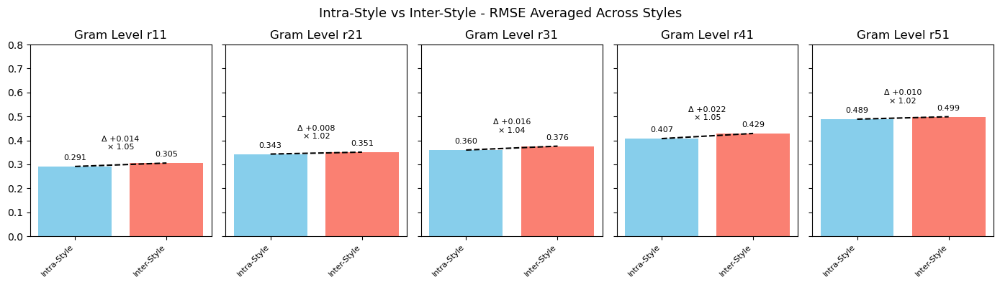

In [32]:
createStyleAveragedBarPlot(normalizedRMSE, "Intra-Style vs Inter-Style - RMSE Averaged Across Styles")

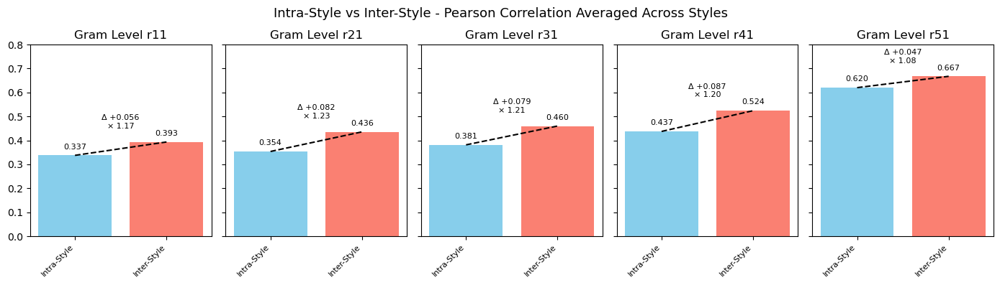

In [33]:
createStyleAveragedBarPlot(normalizedPearsons, "Intra-Style vs Inter-Style - Pearson Correlation Averaged Across Styles")

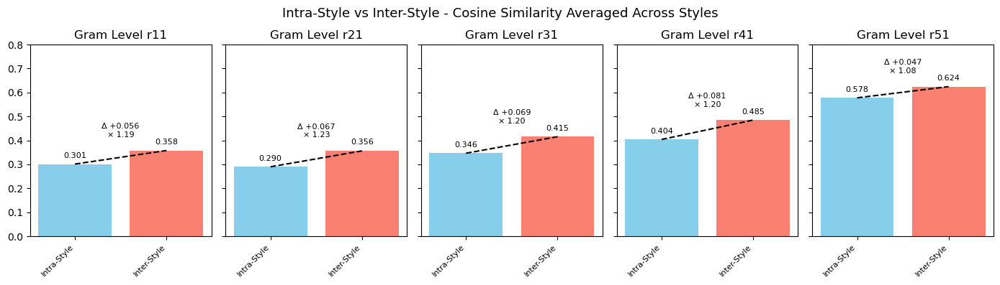

In [34]:
createStyleAveragedBarPlot(normalizedCosines, "Intra-Style vs Inter-Style - Cosine Similarity Averaged Across Styles")

# Averaged by both Gram Layer and Style

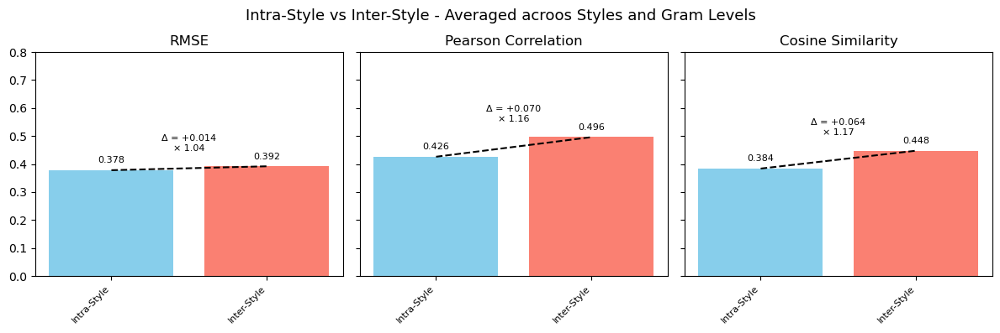

In [35]:
metrics = [
    ("RMSE",               normalizedRMSE),
    ("Pearson Correlation", normalizedPearsons),
    ("Cosine Similarity",   normalizedCosines)
]

fig, axs = plt.subplots(1, 3, figsize=(12, 4), sharey=True)

colors  = ['skyblue', 'salmon']
labels  = ['Intra-Style', 'Inter-Style']
x_pos   = np.arange(2)                     # bar x-coordinates

for ax, (title_metric, mat) in zip(axs, metrics):
    intra_val = computeIntraStyleAvgDistance(mat).mean().item()
    inter_val = computeInterStyleAvgDistance(mat).mean().item()
    diff      = inter_val - intra_val                     # ➊ difference

    bars = ax.bar(x_pos, [intra_val, inter_val], color=colors)

    # numeric labels on the bars
    for b in bars:
        ax.text(b.get_x() + b.get_width()/2, b.get_height() + 0.02,
                f'{b.get_height():.3f}', ha='center', va='bottom', fontsize=8)

    diff  = inter_val - intra_val                    # already had this
    ratio = inter_val / intra_val if intra_val else float("inf")   # ← NEW

    ax.plot(x_pos, [intra_val, inter_val], ls='--', c='k')         # connector
    ax.text(x_pos.mean(), max(intra_val, inter_val) + 0.05,        # difference + ratio
            f'Δ = {diff:+.3f}\n× {ratio:.2f}',
            ha='center', va='bottom', fontsize=8)                   # ← NEW

    ax.set_title(title_metric)
    ax.set_xticks(x_pos)
    ax.set_xticklabels(labels, rotation=45, ha='right', fontsize=8)
    ax.set_ylim(0, 0.8)

fig.suptitle("Intra-Style vs Inter-Style - Averaged acroos Styles and Gram Levels", fontsize=13)
fig.tight_layout()
fig.subplots_adjust(top=0.85)
plt.show()
